In [56]:
import sys
import pickle
from os.path import join
sys.path.append("../../src")

import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import to_rgba
from matplotlib.collections import PolyCollection

from scipy.stats import spearmanr

import video_analyses
from data_processing import *
from plot_utils import *
import mne

import warnings
warnings.filterwarnings("ignore")


# FOR NATURE COMMUNICATIONS GUIDELINES
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = ['Arial']
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300

address_CENIR = '../../../CENIR_NEURORELAXMARKERS/'

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
import pkg_resources

# List of external modules used (excluding standard library modules)
modules = ["pandas", "numpy", "seaborn", "matplotlib", "scipy", "statsmodels", "mne"]

# Create and write to requirements.txt
with open("requirements.txt", "w") as f:
    for module in modules:
        try:
            # Get the version and write it to the file
            version = pkg_resources.get_distribution(module).version
            f.write(f"{module}=={version}\n")
        except pkg_resources.DistributionNotFound:
            print(f"{module} is not installed in the environment.")


In [3]:
# Importing seaborn and matplotlib to check versions
import seaborn as sns
import matplotlib

print(sns.__version__)
print(matplotlib.__version__)
# 0.12.0
# 3.6.0

0.12.0
3.6.0


In [4]:
participants = ['00','01','02','04','05','06','07','08','09','10','11','12','13','14','15', '16', 
                '17', '20', '23', '24', '26', '28', '30','31','32','33','34']

unresponsive_IDs = ['02', '06', '10', '11', '15', '16', '20', '26', '30', '32', '34']
relaxed_IDs = ['00', '01', '04', '05', '07', '08', '09', '12', '13', '14', '17', '23', '24', '28', '31', '33']

## Code to retrieve EEG data

In [5]:
# # Define the electrode order by region
# regions = {
#     'frontal': ['Fp2', 'AF4', 'AF8', 'F8', 'F6', 'F4', 'F2','Fp1', 'AF3', 'AF7', 'F7', 'F5', 'F3', 'F1'],
#     'temporal' : ['FT8', 'FT10', 'T8', 'TP8', 'TP10','FT7', 'FT9', 'T7', 'TP7', 'TP9'],
#     'central': ['FC2', 'FC4', 'FC6', 'C6', 'C4', 'C2','FC1', 'FC3', 'FC5', 'C5', 'C3', 'C1'],
#     'parietal': ['CP2', 'CP4', 'CP6', 'P6', 'P4', 'P2','CP1', 'CP3', 'CP5', 'P5', 'P3', 'P1'],
#     'occipital': ['P8', 'PO8', 'PO4', 'O2','P7', 'PO7', 'PO3', 'O1'],
#     'midline': ['AFz', 'Fz', 'Cz', 'CPz', 'Pz', 'POz', 'Oz', 'Iz']
# }

# alpha_averages_dict = {}
# beta_averages_dict = {}
# theta_averages_dict = {}
# lgamma_averages_dict = {}
# alpha_theta_ratio_avg_dict = {}

# for i in participants:

#     # fetch the .csv files of all participants
#     sub_id = str(i).zfill(3) #fill with putting 0 in front of the number
#     alpha_file = address_CENIR+'Results_PSD/PSD_time_3D_Sub'+ sub_id +'_Alpha.csv'
#     beta_file = address_CENIR+'Results_PSD/PSD_time_3D_Sub'+ sub_id +'_Beta.csv'
#     theta_file = address_CENIR+'Results_PSD/PSD_time_3D_Sub'+ sub_id +'_Theta.csv'
#     lgamma_file = address_CENIR+'Results_PSD/PSD_time_3D_Sub'+ sub_id +'_Lgamma.csv'
    
#     # Read and preprocess the data
#     EEG_df_sub_alpha = read_and_preprocess_csv(alpha_file)
#     EEG_df_sub_beta = read_and_preprocess_csv(beta_file)
#     EEG_df_sub_theta = read_and_preprocess_csv(theta_file)
#     EEG_df_sub_lgamma = read_and_preprocess_csv(lgamma_file)

#     # Calculate total power
#     EEG_df_sub_total_power = calculate_total_power(EEG_df_sub_alpha, EEG_df_sub_beta, EEG_df_sub_theta, EEG_df_sub_lgamma)
    
#     # Calculate relative power for each band
#     EEG_df_sub_alpha_relative_power = calculate_relative_power(EEG_df_sub_alpha, EEG_df_sub_total_power)
#     EEG_df_sub_beta_relative_power = calculate_relative_power(EEG_df_sub_beta, EEG_df_sub_total_power)
#     EEG_df_sub_theta_relative_power = calculate_relative_power(EEG_df_sub_theta, EEG_df_sub_total_power)
#     EEG_df_sub_lgamma_relative_power = calculate_relative_power(EEG_df_sub_lgamma, EEG_df_sub_total_power)

#     # Calculate alpha / theta ratio
#     EEG_df_sub_alpha_theta_ratio = calculate_alpha_theta_ratio(EEG_df_sub_alpha_relative_power, EEG_df_sub_theta_relative_power)

#     # Calculate averages by region
#     alpha_averages_df = calculate_averages_by_region(EEG_df_sub_alpha_relative_power, regions, bandname='alpha')
#     beta_averages_df = calculate_averages_by_region(EEG_df_sub_beta_relative_power, regions, bandname='beta')
#     theta_averages_df = calculate_averages_by_region(EEG_df_sub_theta_relative_power, regions, bandname='theta')
#     lgamma_averages_df = calculate_averages_by_region(EEG_df_sub_lgamma_relative_power, regions, bandname='lgamma')
#     alpha_theta_ratio_avg_df = calculate_averages_by_region(EEG_df_sub_alpha_theta_ratio, regions, bandname='alpha_theta_ratio')

#     # Remove leading zeros from sub_id
#     sub_id = str(i).zfill(2)

#     # create alpha, beta, theta, lgamma, alpha theta ratio dictionaries with sub_id as key and the averages_df as value
#     alpha_averages_dict[sub_id] = alpha_averages_df
#     beta_averages_dict[sub_id] = beta_averages_df
#     theta_averages_dict[sub_id] = theta_averages_df
#     lgamma_averages_dict[sub_id] = lgamma_averages_df
#     alpha_theta_ratio_avg_dict[sub_id] = alpha_theta_ratio_avg_df

_________________________

### IMPORT EEG DATA (DIRECTLY FROM PICKLE)

In [6]:
files = [
    ('alpha_averages_dict_cleaned.pickle', 'alpha_averages'),
    ('beta_averages_dict_cleaned.pickle', 'beta_averages'),
    ('alpha_averages_2D_dict_cleaned.pickle', 'alpha_averages_2D'),
    ('beta_averages_2D_dict_cleaned.pickle', 'beta_averages_2D')
]

for filename, variable_name in files:
    file_path = join('..', 'data', filename) 
    with open(file_path, 'rb') as handle:
        data_dict = pickle.load(handle)
        globals()[variable_name] = pd.concat(data_dict.values())

beta_averages_2D.head()

,frontal_beta,temporal_beta,central_beta,parietal_beta,occipital_beta,midline_beta,Time,ID
1,0.278098,0.299352,0.309159,0.297690,0.283117,0.289844,1,00
2,0.285144,0.275057,0.293947,0.280718,0.275493,0.277542,2,00
3,0.267578,0.278197,0.290168,0.278361,0.272991,0.263316,3,00
4,0.286424,0.286572,0.295433,0.287110,0.277675,0.277370,4,00
5,0.284382,0.287652,0.294483,0.291062,0.287835,0.285692,5,00


# IMPORT EEG DATA 

In [7]:
melted_data_EEG_beta = pd.read_csv(join('..', 'data', 'melted_data_EEG_beta_new.csv'))
melted_data_EEG_alpha = pd.read_csv(join('..', 'data', 'melted_data_EEG_alpha_new.csv'))

### IMPORT ECG DATA

In [8]:
LF_3D_normalized = pd.read_csv(join('..', 'data', 'LF_3D_normalized.csv'))
LF_2D_normalized = pd.read_csv(join('..', 'data', 'LF_2D_normalized.csv'))
HF_3D_normalized = pd.read_csv(join('..', 'data', 'HF_3D_normalized.csv'))
HF_2D_normalized = pd.read_csv(join('..', 'data', 'HF_2D_normalized.csv'))
Fratio_3D_normalized = pd.read_csv(join('..', 'data', 'Fratio_3D_normalized.csv'))
Fratio_2D_normalized = pd.read_csv(join('..', 'data', 'Fratio_2D_normalized.csv'))

LF_3D_normalized.head()

,Unnamed: 0,LF_avg_00,LF_avg_01,LF_avg_02,LF_avg_04,LF_avg_05,LF_avg_06,LF_avg_07,LF_avg_08,LF_avg_09,...,LF_avg_30,LF_avg_31,LF_avg_32,LF_avg_33,LF_avg_34,Avg,Std,time,Std_smooth,Avg_smooth
0,0,0.120580,0.314118,0.282461,0.112915,0.223188,0.167877,0.247872,0.244886,0.465616,...,0.113256,0.019856,0.201690,0.035317,0.142828,0.220174,0.135385,60,0.135385,0.220174
1,1,0.274607,0.340863,0.444117,0.237199,0.436539,0.209137,0.199086,0.432089,0.938753,...,0.089333,0.264370,0.566033,0.054771,0.105284,0.305209,0.198026,65,0.166705,0.262692
2,2,0.380997,0.438966,0.237398,0.434605,0.305502,0.215840,0.244428,0.381090,0.965082,...,0.099743,0.310257,0.605865,0.066671,0.156149,0.328211,0.199842,70,0.177751,0.284532
3,3,0.644636,0.429997,0.252595,0.485999,0.312102,0.205922,0.531929,0.352811,0.807983,...,0.110339,0.372794,0.584428,0.056654,0.212541,0.357051,0.193929,75,0.181795,0.302661
4,4,0.504642,0.423171,0.355214,0.527290,0.745225,0.218669,0.588877,0.416779,0.887344,...,0.138587,0.386724,0.629668,0.060399,0.304992,0.401636,0.222675,80,0.189971,0.322456


### IMPORT STAIY SCORES

In [9]:
STAIY = pd.read_csv(join('..', 'Data', 'STAIY-SCORES.csv'), sep=';') #sep= ',' plutôt ? ça bugait avant
STAIY['order'] = STAIY['order'].astype(str)
#STAIY['group'] = STAIY['group'].replace({0:1, 1:0}) #quand j'avais inversé les 0 et les 1 dans csv, c'était pour inverser automatiquement, mais maintenant c'est corrigé normalement
STAIY.head()

,Participant,score,order,group
0,0,35,0,0
1,1,31,0,0
2,2,34,0,1
3,4,28,0,0
4,5,37,0,0


### PROCESS EEG DATA (VIOLIN PLOTS, regions comparison)

In [10]:
melted_data_EEG_alpha_regions_POST, melted_data_EEG_beta_regions_POST = calculate_average_by_ID_all(alpha_averages, 
                                                                    alpha_averages_2D, beta_averages, beta_averages_2D, 'after', relaxed_IDs)
melted_data_EEG_beta_regions_POST.head()

,ID,condition,group,variable,value
0,0,0,0,frontal_beta,0.287453
1,1,0,0,frontal_beta,0.290574
2,2,0,1,frontal_beta,0.278200
3,4,0,0,frontal_beta,0.297534
4,5,0,0,frontal_beta,0.304855


In [11]:
melted_data_EEG_beta

,ID,condition,group,variable,value
0,0,0,0,frontal_beta,-0.425992
1,1,0,0,frontal_beta,0.035287
2,2,0,1,frontal_beta,-1.793399
3,4,0,0,frontal_beta,1.063842
4,5,0,0,frontal_beta,2.145744
...,...,...,...,...,...
265,30,1,1,temporal_beta,0.871743
266,31,1,0,temporal_beta,-1.227971
267,32,1,1,temporal_beta,-2.066353
268,33,1,0,temporal_beta,-0.494385


### Et la normalization n'avait pas été faire en enlevant le breathing donc les données ne sont pas 100% correctes (tu me dis si c'est pas très clair?) donc on corrigerait ou enlèvera cette partie

# le mieux sera qu'on utilise les données correctes directement et qu'on mette ta méthode de segmentation en partie commentée au début :) 

### PROCESS ECG DATA (TEMPORAL PLOTS)

In [12]:
data_types = ['LF', 'HF', 'Fratio']

new_melted_ECG_POST = pd.concat([
    calculate_average_by_ID_all_ECG(globals()[f"{data_type}_3D_normalized"].copy(),globals()[f"{data_type}_2D_normalized"].copy()) 
    for data_type in data_types
], ignore_index=True)

new_melted_ECG_POST['group'] = new_melted_ECG_POST['ID'].apply(lambda x: 0 if f'{x:02}' in relaxed_IDs 
                                                               else (1 if f'{x:02}' in unresponsive_IDs else None))
new_melted_ECG_POST.head()

,ID,condition,variable,value,group
0,0,0,LF_avg,0.603514,0
1,1,0,LF_avg,1.505677,0
2,2,0,LF_avg,0.453829,1
3,4,0,LF_avg,-0.280156,0
4,5,0,LF_avg,-0.353494,0


Combine EEG data (midline alpha and beta) with the 3 ECG metrics (LF, HF, Fratio)

In [13]:
new_melted_data_POST = pd.concat([
    new_melted_ECG_POST,
    melted_data_EEG_beta_regions_POST[melted_data_EEG_beta_regions_POST['variable'] == 'midline_beta'],
    melted_data_EEG_alpha_regions_POST[melted_data_EEG_alpha_regions_POST['variable'] == 'midline_alpha']
]).reset_index(drop=True)

In [14]:
# import melted_data all

melted_data_physio = pd.read_csv(join('..', 'data', 'df_physio_melted.csv'))

## Figure 1. Condition effects on STAI-Y1 ratings, neural and cardiac correlates.

[35 31 34 28 37 20 29 30 42 21 36 27 37 34 32 25 26 43 23 41 29 27 22 35
 24 73 26] [29 22 34 21 30 20 27 23 25 25 42 24 24 30 35 28 24 44 21 29 30 23 25 33
 24 24 31]


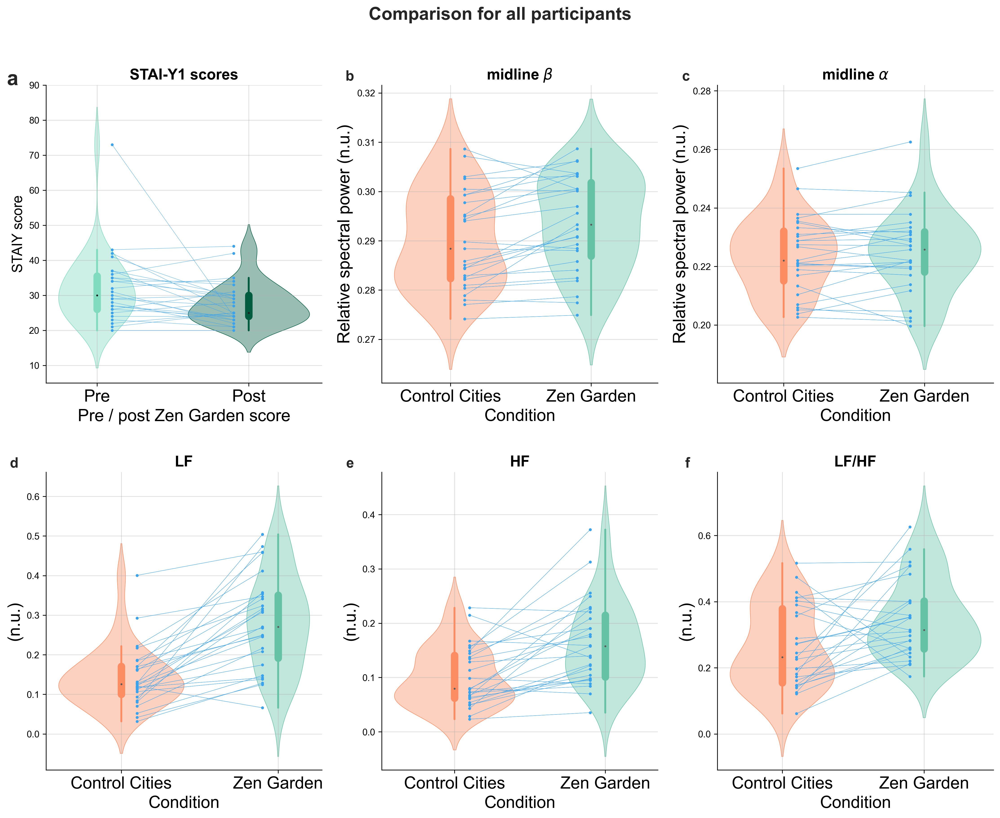

In [15]:
violin_plots_metrics_and_staiy(melted_data_physio, STAIY, None, 'all', 0)
# violin_plots_metrics_and_staiy(new_melted_data_POST, STAIY, 0, 'responsive', 0)
# violin_plots_metrics_and_staiy(new_melted_data_POST, STAIY, 1, 'unresponsive', 0)

## Figure 2. ECG HF spectral component differences across conditions in all participants and each subgroup.

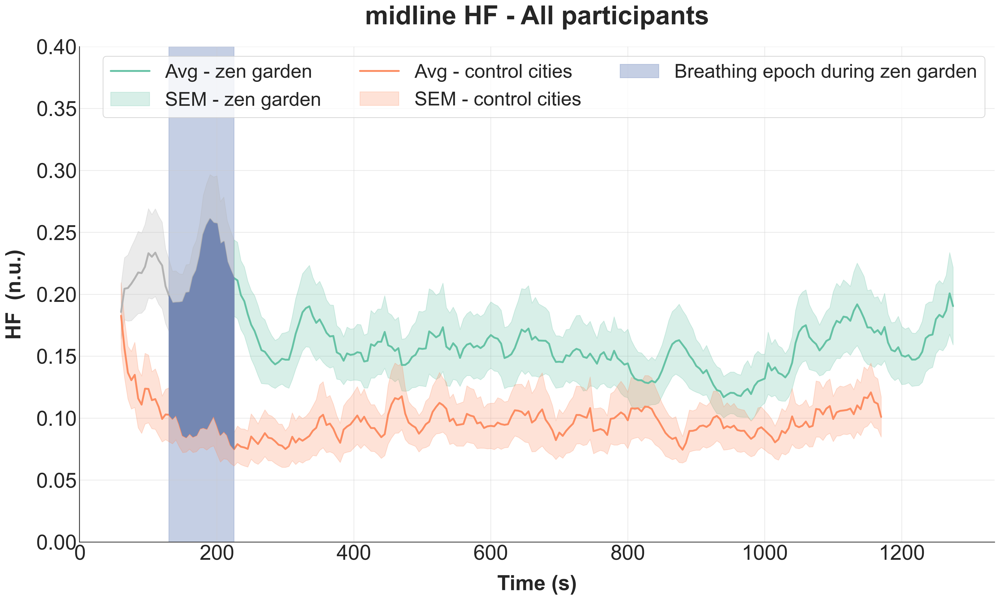

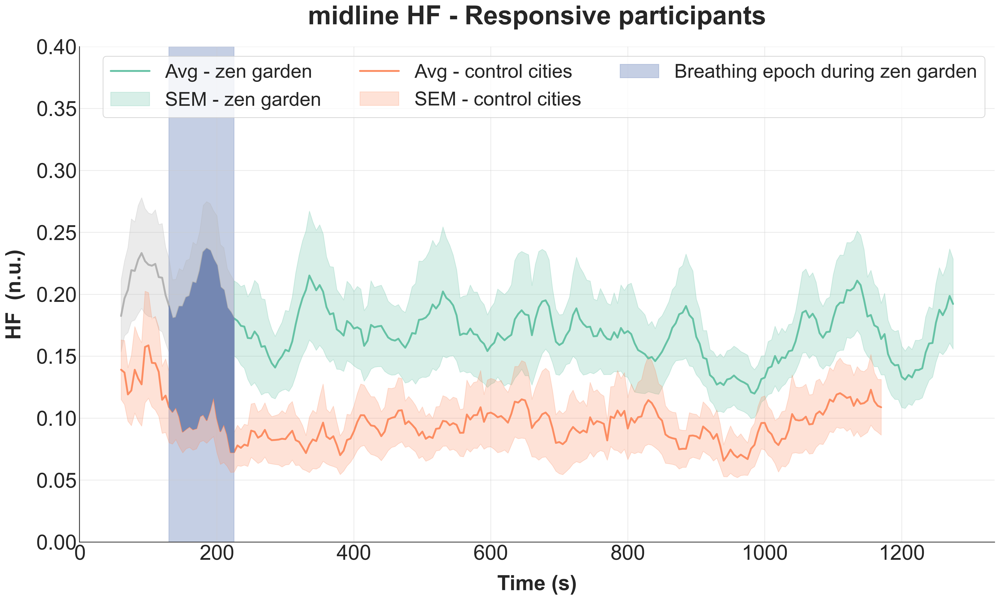

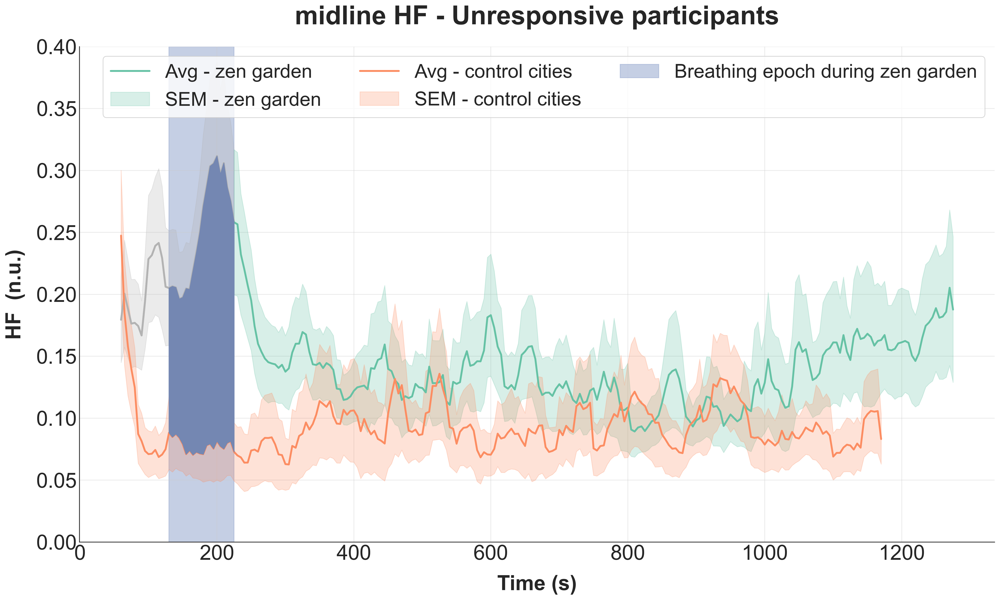

In [16]:
smoothness = 5
subgroups = [unresponsive_IDs, relaxed_IDs]
HF_unresponsive_3D, HF_unresponsive_2D, HF_relaxed_3D, HF_relaxed_2D = divide_ECG_into_groups(globals()[f"{'HF'}_3D_normalized"], globals()[f"{'HF'}_2D_normalized"], subgroups, 'HF')

temporal_plot_comparison(HF_3D_normalized, HF_2D_normalized, region='HF', band='', type='ECG', participants='All',highlight_epoch_start= 14, highlight_epoch_end=33, smoothness=5, leg_pos='upper right', n=27)
temporal_plot_comparison(HF_relaxed_3D, HF_relaxed_2D, region='HF', band='', type='ECG', participants='Responsive', highlight_epoch_start=14, highlight_epoch_end=33, smoothness=smoothness, leg_pos='upper right', n=16)
temporal_plot_comparison(HF_unresponsive_3D, HF_unresponsive_2D, region='HF', band='', type='ECG', participants='Unresponsive', highlight_epoch_start=14, highlight_epoch_end=33, smoothness=smoothness, leg_pos='upper right', n=11)

## Figure 3. ECG LF/HF ratio differences across conditions in all participants and each subgroup.

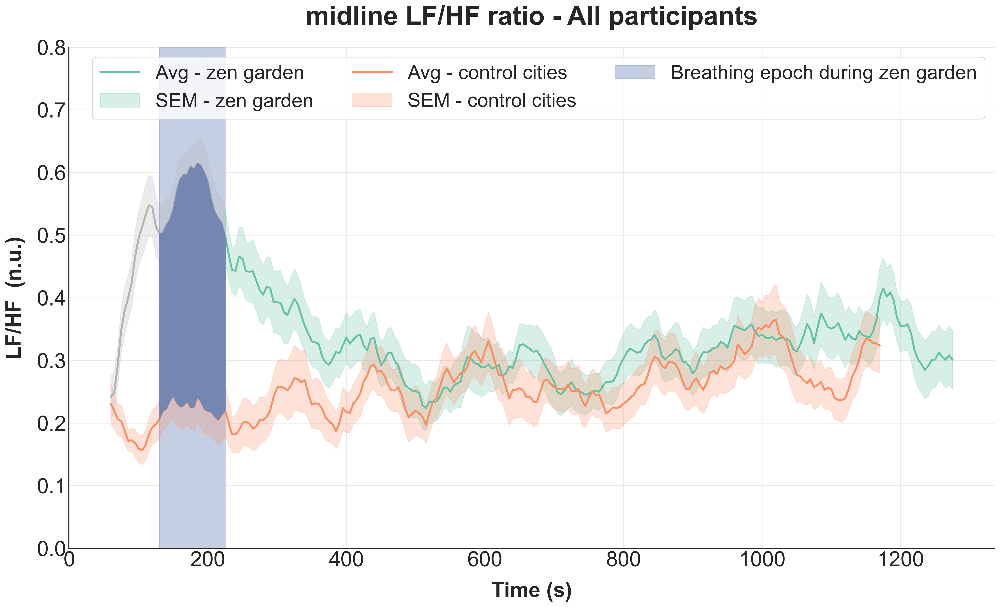

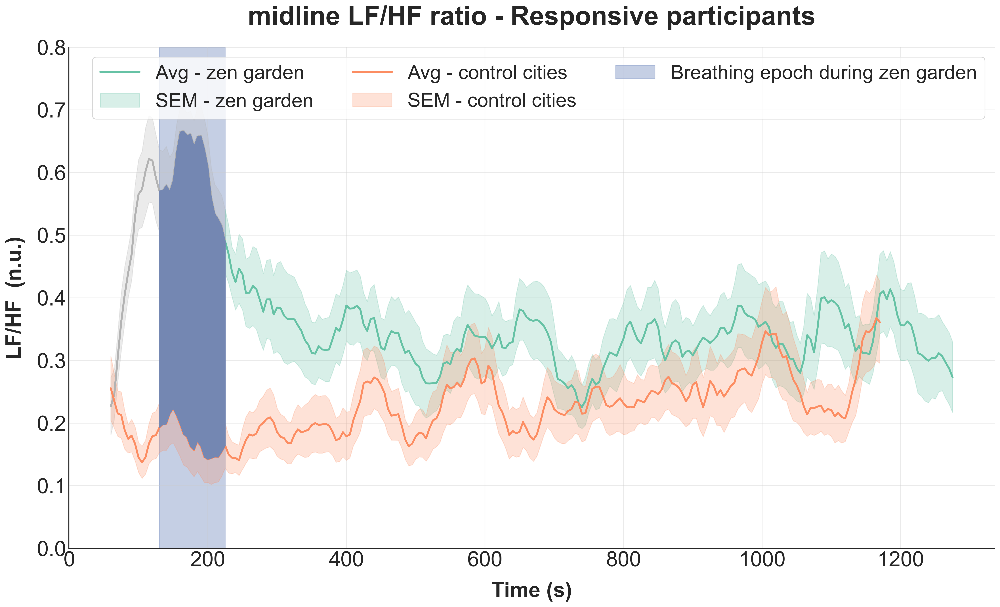

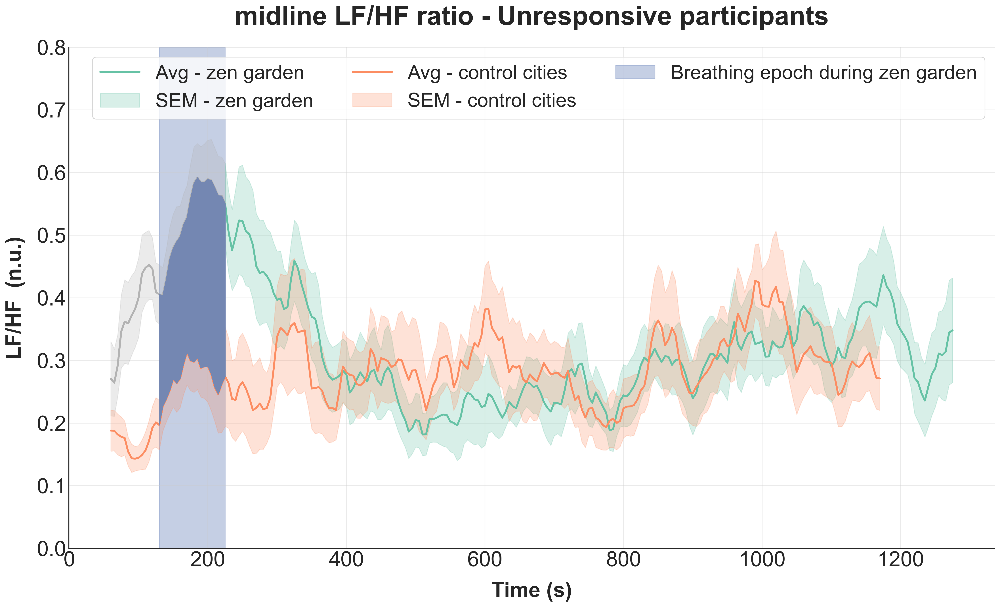

In [17]:
smoothness = 2
subgroups = [unresponsive_IDs, relaxed_IDs]
Fratio_unresponsive_3D, Fratio_unresponsive_2D, Fratio_relaxed_3D, Fratio_relaxed_2D = divide_ECG_into_groups(globals()[f"{'Fratio'}_3D_normalized"], globals()[f"{'Fratio'}_2D_normalized"], subgroups, 'Fratio')

temporal_plot_comparison(Fratio_3D_normalized, Fratio_2D_normalized, region='LF/HF', band='', type='ECG', participants='All', highlight_epoch_start= 14, highlight_epoch_end=33, smoothness=2, leg_pos='upper right', n=27)
temporal_plot_comparison(Fratio_relaxed_3D, Fratio_relaxed_2D, region='LF/HF', band='', type='ECG', participants='Responsive', highlight_epoch_start=14, highlight_epoch_end=33, smoothness=smoothness, leg_pos='upper right', n=16)
temporal_plot_comparison(Fratio_unresponsive_3D, Fratio_unresponsive_2D, region='LF/HF', band='', type='ECG', participants='Unresponsive', highlight_epoch_start=14, highlight_epoch_end=33, smoothness=smoothness, leg_pos='upper right', n=11)

## Figure 4. EEG beta band relative spectral power response in each subgroup.

To display the same temporal analysis but for the alpha band instead of beta, please decomment the line below in the "for loop"

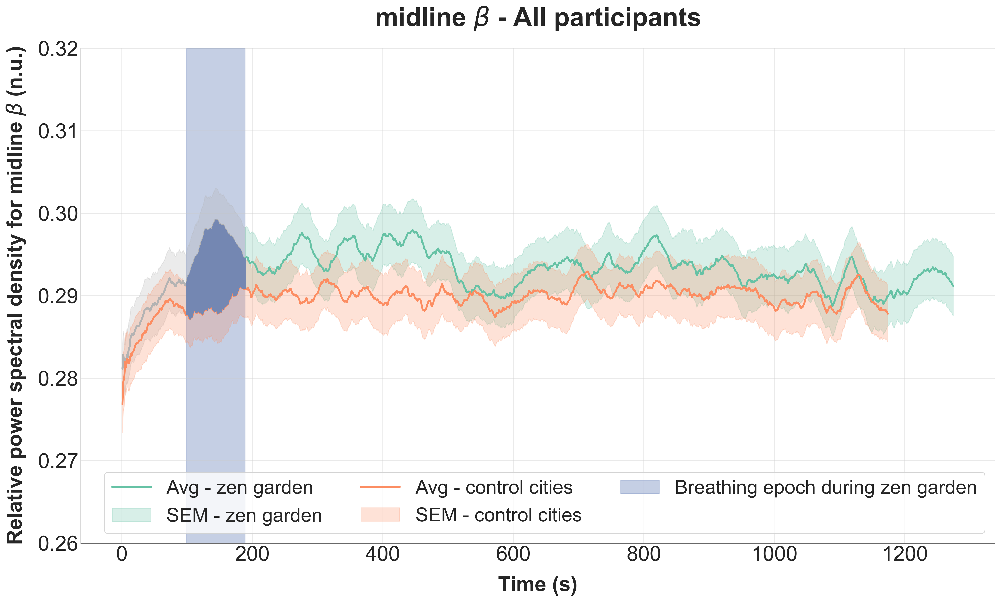

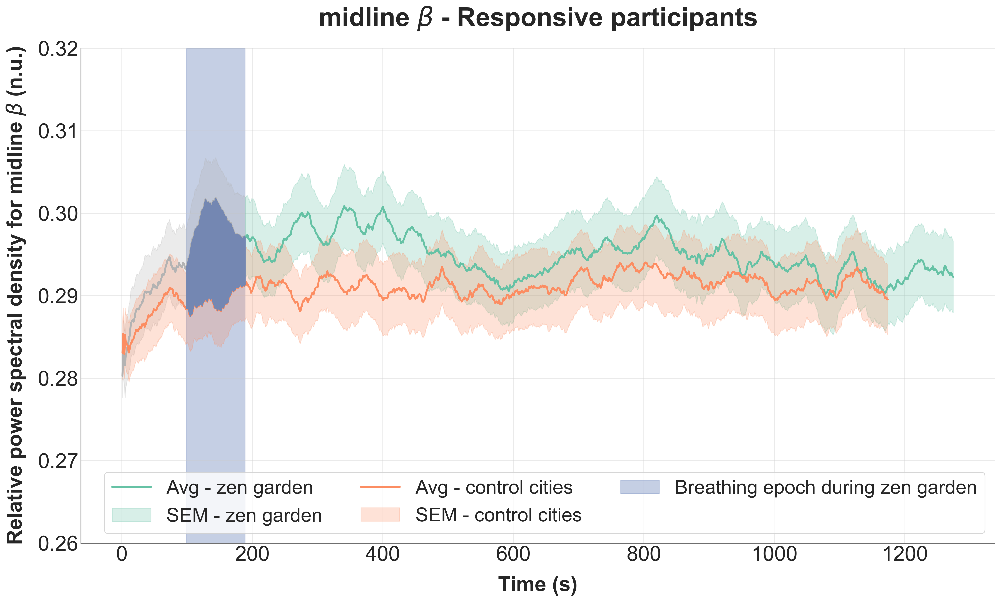

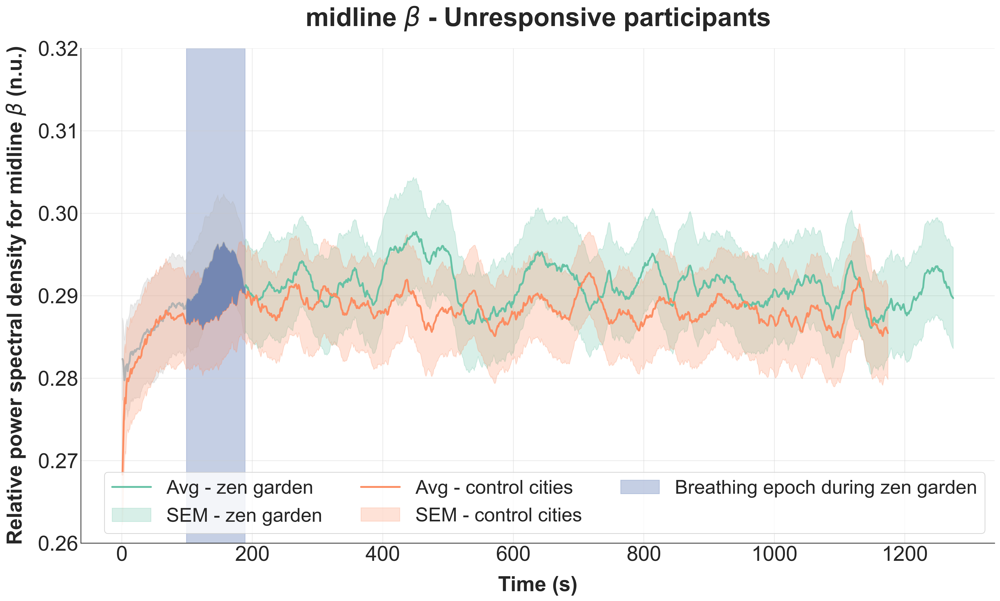

In [18]:
participant_groups = [
    {'group': participants, 'label': 'All', 'n': 27},
    {'group': relaxed_IDs, 'label': 'Responsive','n':16},
    {'group': unresponsive_IDs, 'label': 'Unresponsive', 'n': 11}
]

for group_info in participant_groups:
    
    group, label, number = group_info['group'], group_info['label'], group_info['n']

    # Computes the average across participants of same group (all, resp, unresp)
    regions_alpha, regions_beta, regions_2D_alpha, regions_2D_beta = process_EEG_by_group(alpha_averages, beta_averages, alpha_averages_2D, beta_averages_2D, group)

    # BETA BAND
    temporal_plot_comparison(regions_beta.copy(), regions_2D_beta.copy(), region='midline', band='beta', type='EEG', participants=label, highlight_epoch_start=98, highlight_epoch_end=188, smoothness=30, leg_pos='lower right', n=number)

    # ALPHA BAND
    # temporal_plot_comparison(regions_alpha.copy(), regions_2D_alpha.copy(), region='midline', band='alpha', type='EEG', participants=label, highlight_epoch_start=98, highlight_epoch_end=188, smoothness=30, leg_pos='lower right', n=number)


## Violin plots of responsive and unresponsive groups visible in Figures 2. 3. & 4. c. & e. 

[35 31 28 37 29 30 42 27 37 34 26 23 41 27 35 73] [29 22 21 30 27 23 25 24 24 30 24 21 29 23 33 24]


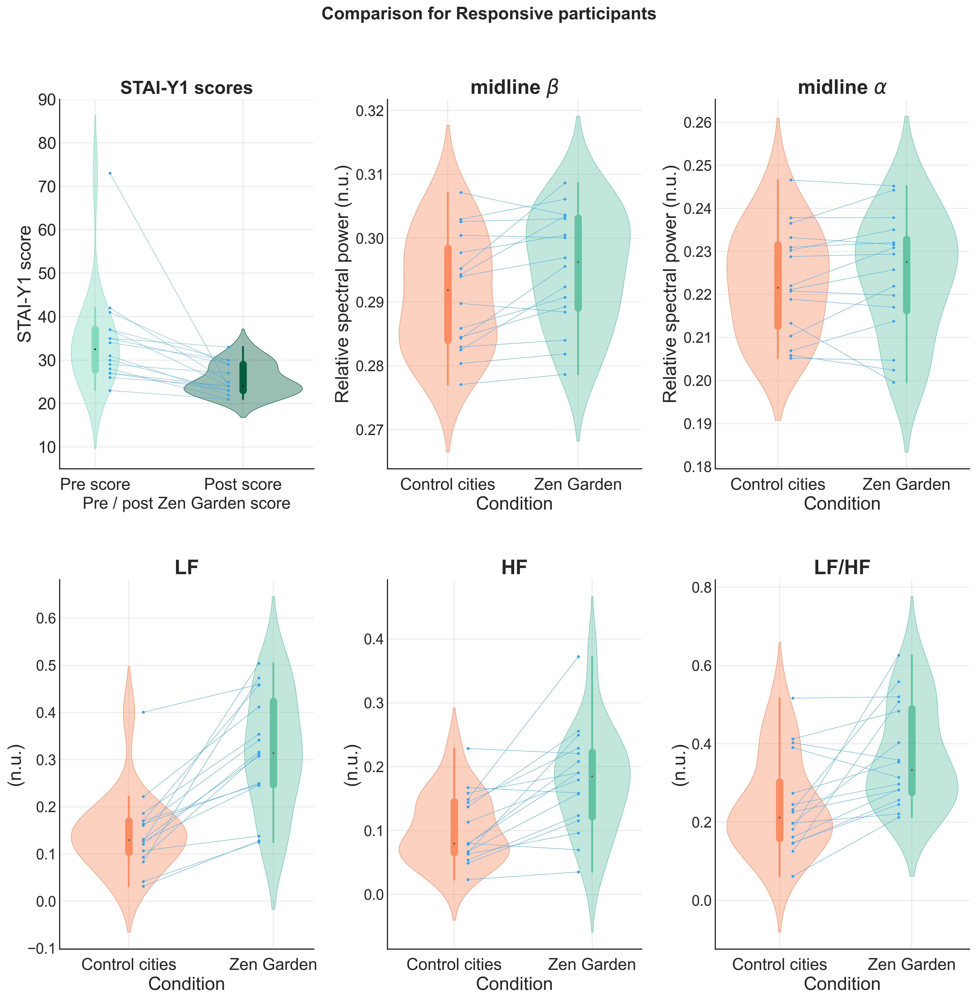

[34 20 21 36 32 25 43 29 22 24 26] [34 20 25 42 35 28 44 30 25 24 31]


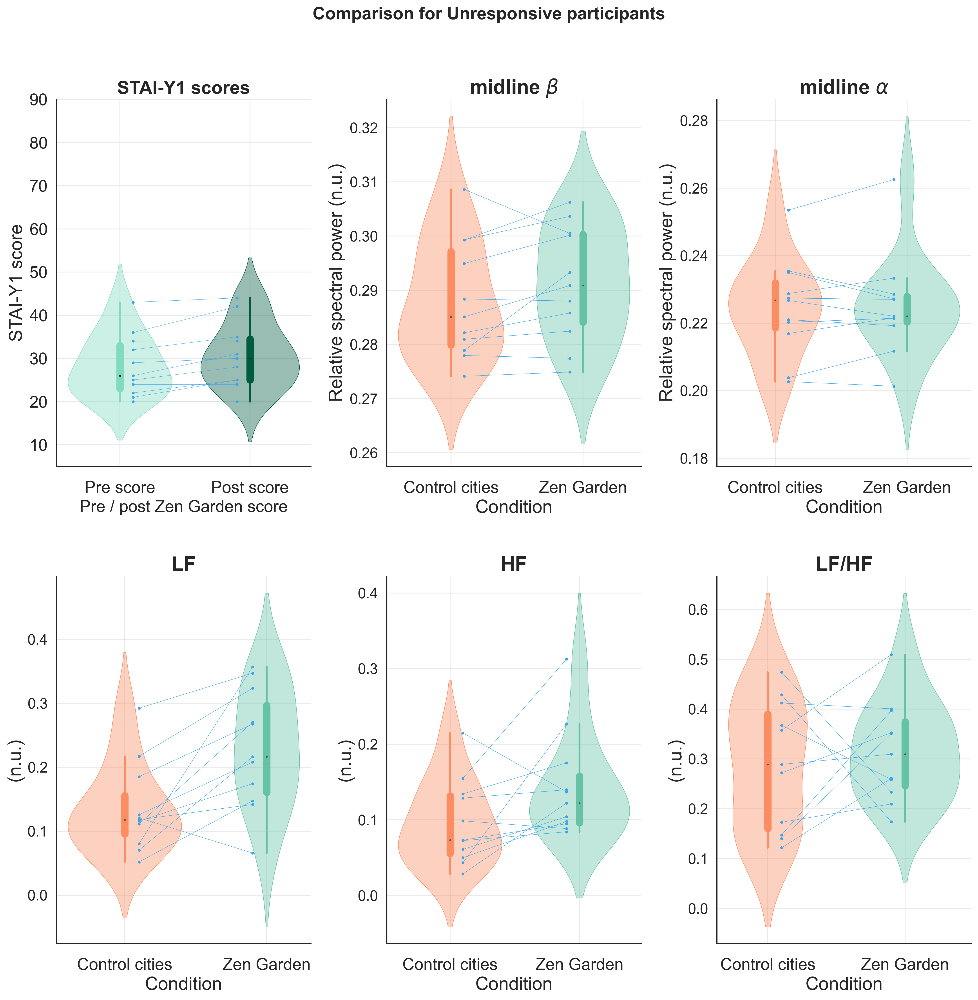

In [19]:
violin_plots_metrics_and_staiy_subgroups(melted_data_physio, STAIY, 0, 'Responsive', 0)
violin_plots_metrics_and_staiy_subgroups(melted_data_physio, STAIY, 1, 'Unresponsive', 0)

In [20]:
new_melted_data_POST

,ID,condition,variable,value,group
0,0,0,LF_avg,0.603514,0
1,1,0,LF_avg,1.505677,0
2,2,0,LF_avg,0.453829,1
3,4,0,LF_avg,-0.280156,0
4,5,0,LF_avg,-0.353494,0
...,...,...,...,...,...
281,30,1,midline_alpha,0.204420,1
282,31,1,midline_alpha,0.237717,0
283,32,1,midline_alpha,0.227102,1
284,33,1,midline_alpha,0.205523,0


In [21]:
melted_data_physio

,ID,condition,group,variable,value
0,0,1,0,LF_avg,0.093377
1,0,1,0,HF_avg,0.067410
2,0,1,0,Fratio_avg,0.196809
3,0,1,0,midline_alpha,0.246577
4,0,1,0,midline_beta,0.289777
...,...,...,...,...,...
265,34,0,1,LF_avg,0.208188
266,34,0,1,HF_avg,0.136939
267,34,0,1,Fratio_avg,0.396775
268,34,0,1,midline_alpha,0.219253


In [22]:
melted_data_physio

,ID,condition,group,variable,value
0,0,1,0,LF_avg,0.093377
1,0,1,0,HF_avg,0.067410
2,0,1,0,Fratio_avg,0.196809
3,0,1,0,midline_alpha,0.246577
4,0,1,0,midline_beta,0.289777
...,...,...,...,...,...
265,34,0,1,LF_avg,0.208188
266,34,0,1,HF_avg,0.136939
267,34,0,1,Fratio_avg,0.396775
268,34,0,1,midline_alpha,0.219253


## Figure 5. Brain-to-heart coupling coefficients across conditions in responsive and unresponsive groups.


--------

# SUPPLEMENTARY MATERIALS

## Supplemental Figure. 1. STAI-Y1 scores of each group.

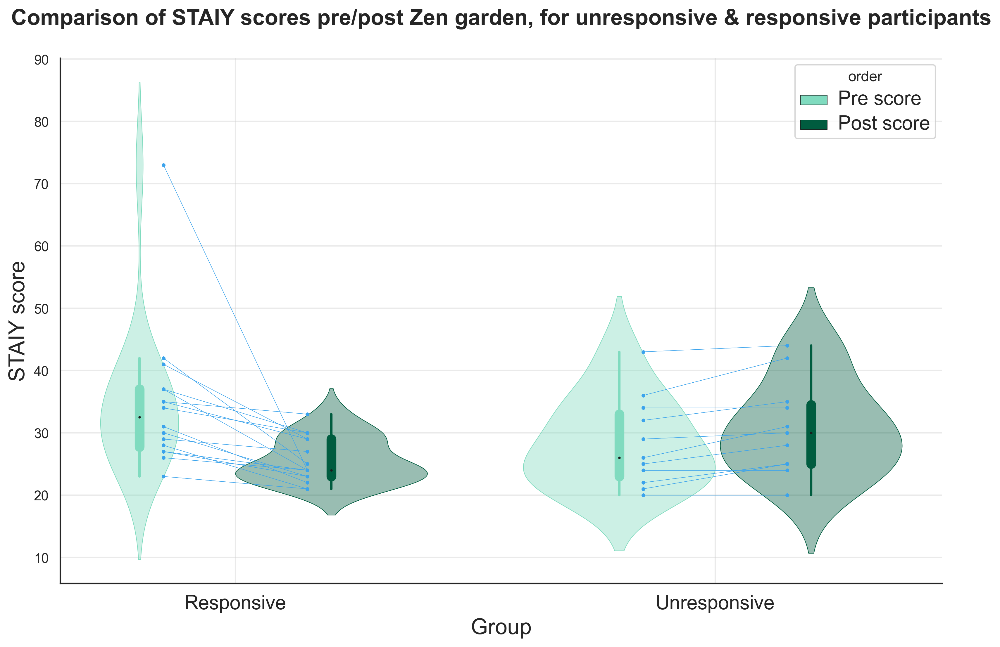

In [62]:
violin_plots_staiy(STAIY)

## Supplemental Figure. 2. Baseline STAI-Y1 scores of each group.

In [24]:
# plot_baseline_staiy(df, group=None, subtitle=None)

## Supplemental Figure. Condition effects on beta neural correlates for each region (responsive / unresponsive)

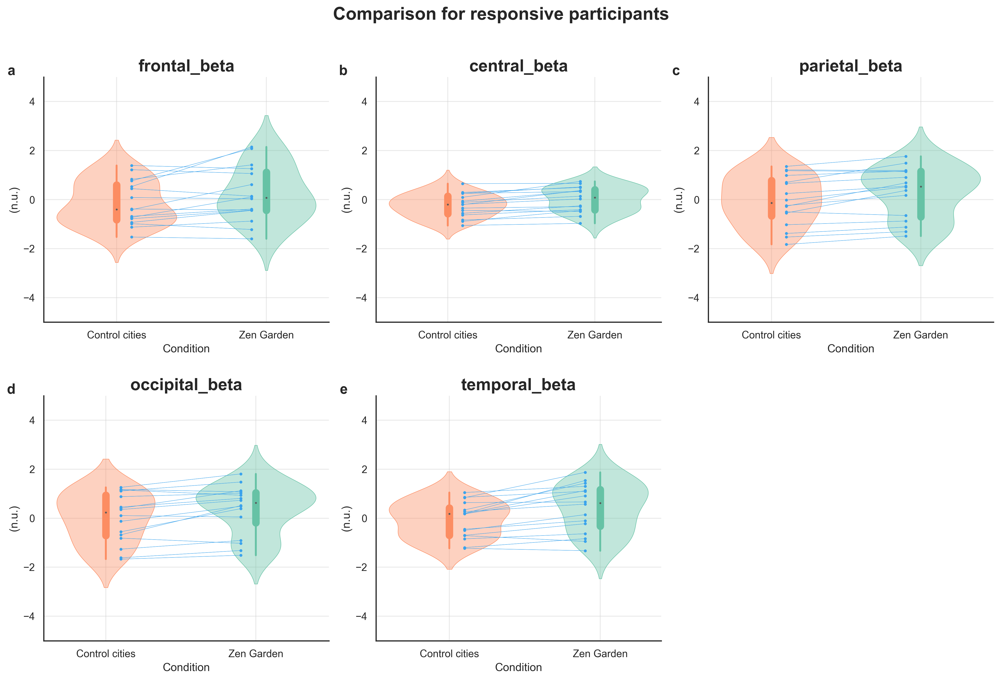

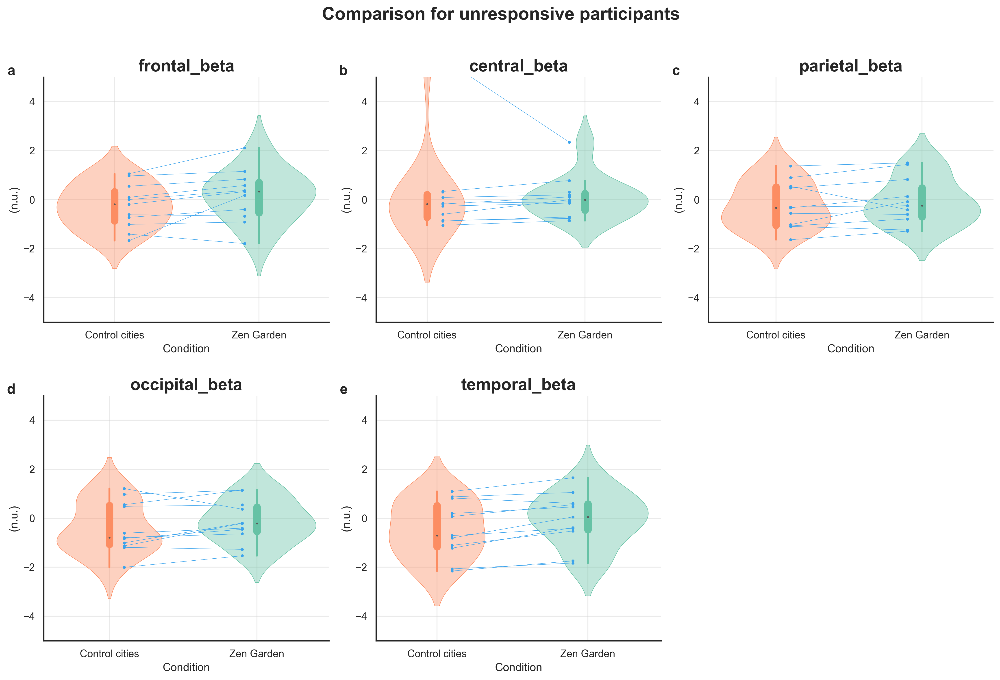

In [25]:
melted_data_beta = pd.read_csv("../Data/melted_data_EEG_beta_new.csv") # before wavelet and normalisation without breathing

violin_plots_EEG_regions(melted_data_beta, 0, 'responsive','beta')
violin_plots_EEG_regions(melted_data_beta, 1, 'unresponsive','beta')

## Supplemental Figure. Condition effects on alpha neural correlates for each region (responsive / unresponsive)

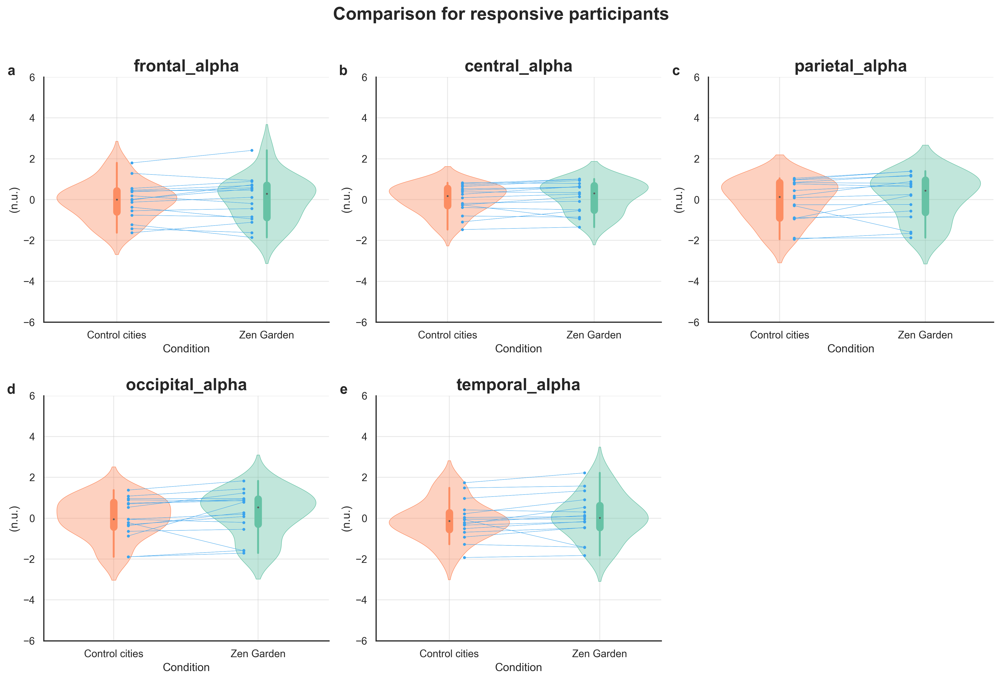

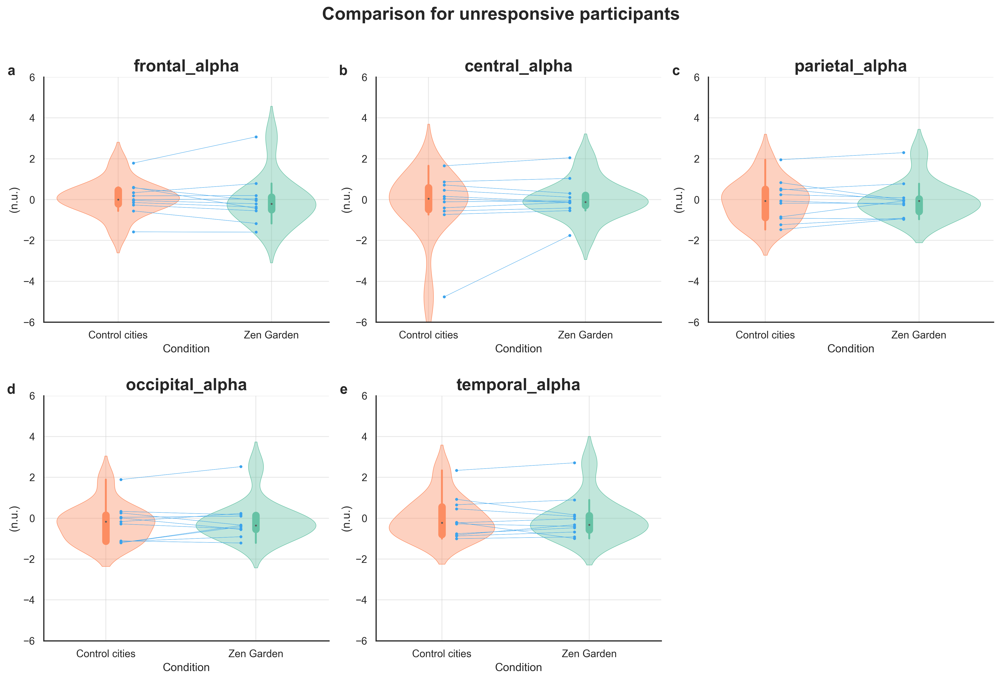

In [26]:
melted_data_alpha = pd.read_csv(join('..', 'Data', 'melted_data_EEG_alpha_new.csv')) # RECENT VERSION
violin_plots_EEG_regions(melted_data_alpha, 0, 'responsive')
violin_plots_EEG_regions(melted_data_alpha, 1, 'unresponsive')

## Supplemental Figure. ECG LF spectral component differences across conditions in each subgroup.

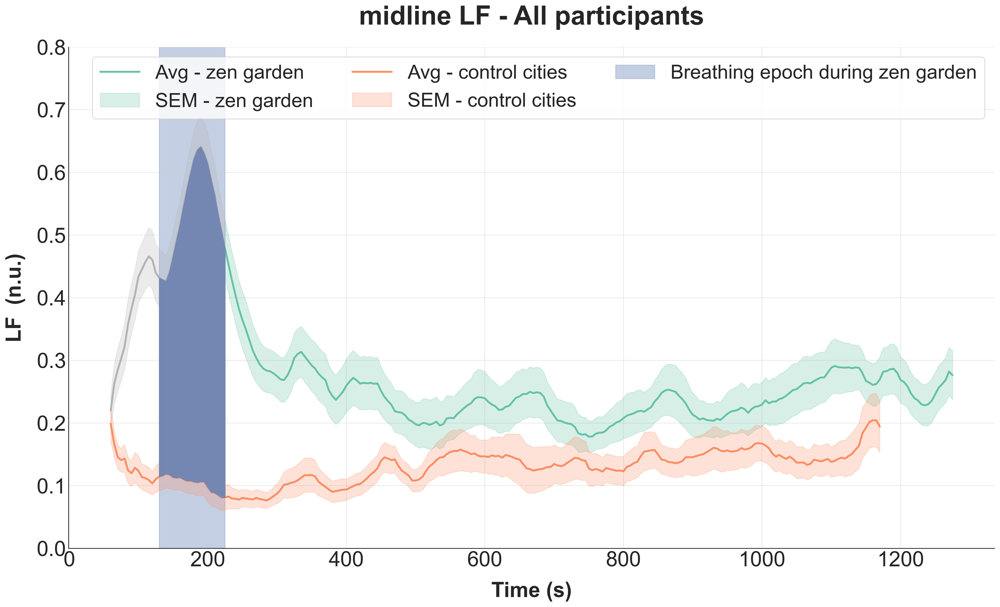

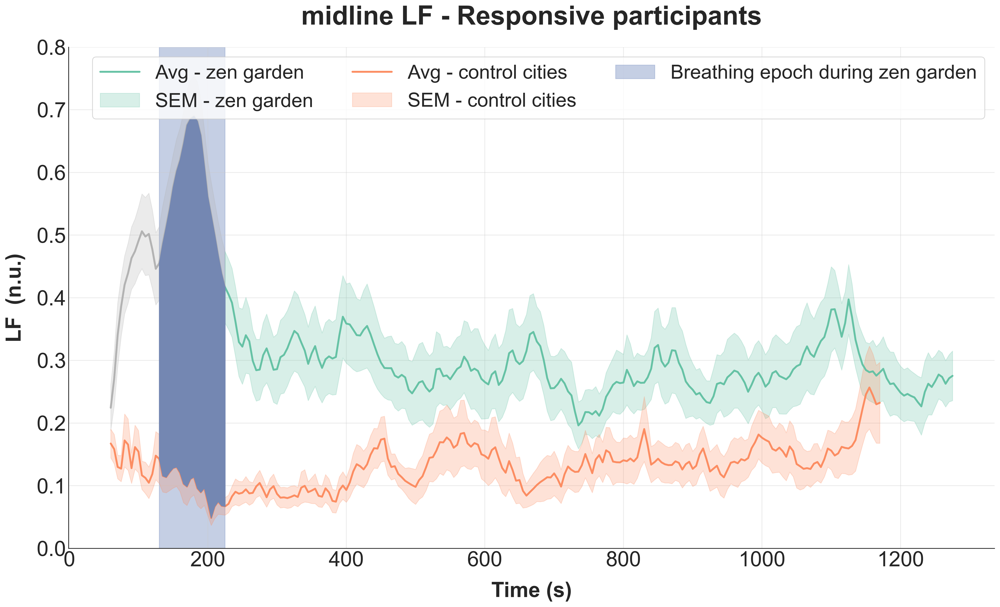

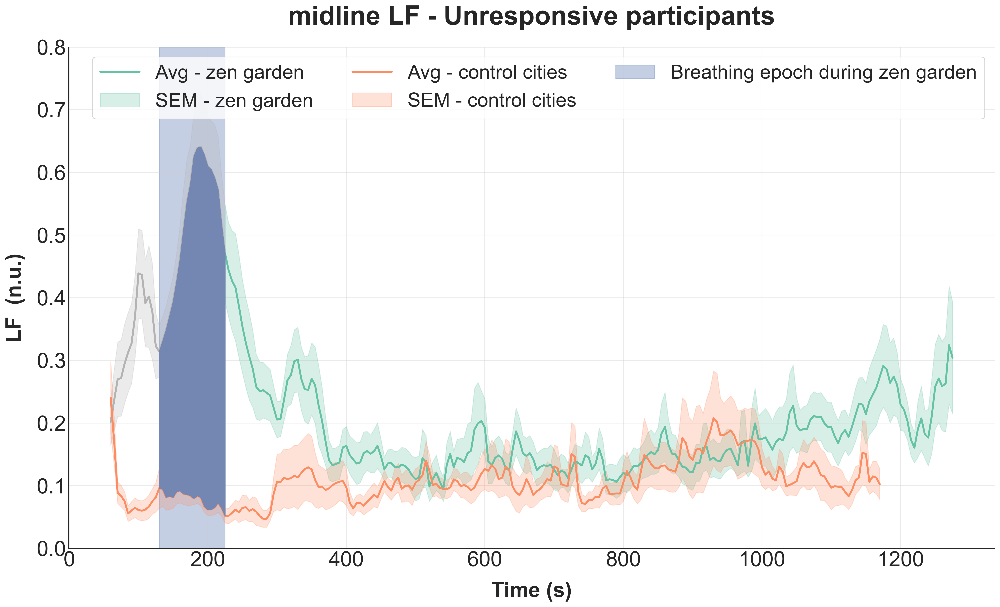

In [27]:
smoothness = 2
subgroups = [unresponsive_IDs, relaxed_IDs]
LF_unresponsive_3D, LF_unresponsive_2D, LF_relaxed_3D, LF_relaxed_2D = divide_ECG_into_groups(globals()[f"{'LF'}_3D_normalized"], globals()[f"{'LF'}_2D_normalized"], subgroups, 'LF')

temporal_plot_comparison(LF_3D_normalized, LF_2D_normalized, region='LF', band='', type='ECG', participants='All',highlight_epoch_start= 14, highlight_epoch_end=33, smoothness=5, leg_pos='upper right', n=27)
temporal_plot_comparison(LF_relaxed_3D, LF_relaxed_2D, region='LF', band='', type='ECG', participants='Responsive', highlight_epoch_start=14, highlight_epoch_end=33, smoothness=smoothness, leg_pos='upper right', n=16)
temporal_plot_comparison(LF_unresponsive_3D, LF_unresponsive_2D, region='LF', band='', type='ECG', participants='Unresponsive', highlight_epoch_start=14, highlight_epoch_end=33, smoothness=smoothness, leg_pos='upper right', n=11)

## TOPOGRAPHIC MAPS

In [28]:
# df_alphas_all = means_by_region(melted_data_alpha, group_option='all')
# df_alphas_all.to_csv(address_output+'/means_alpha_regions_all.csv', index=False)

df_alpha_groups = means_by_region(melted_data_alpha, group_option='groups')
# df_alpha_groups.to_csv('means_alpha_regions_groups.csv', index=False)
df_alpha_groups.head()

,condition,variable,group,value
0,0,central_alpha,0,0.131240
1,0,frontal_alpha,0,0.020820
2,0,occipital_alpha,0,0.238575
3,0,parietal_alpha,0,0.115817
4,0,temporal_alpha,0,0.069905


In [29]:
# df_betas_all = means_by_region(melted_data_beta, group_option='all')
# df_betas_all.to_csv('means_beta_regions_all.csv', index=False)

df_beta_groups = means_by_region(melted_data_beta, group_option='groups')
#df_beta_groups.to_csv('means_beta_regions_groups.csv', index=False)
df_beta_groups.head()

,condition,variable,group,value
0,0,central_beta,0,0.005735
1,0,frontal_beta,0,0.217092
2,0,occipital_beta,0,0.354335
3,0,parietal_beta,0,0.281928
4,0,temporal_beta,0,0.412516


In [30]:
melted_data_new = pd.read_csv(join('..', 'Data', 'melted_data_new.csv'))
melted_data_new['condition'] = melted_data_new['condition'].apply(lambda x: 1 if x == 0 else 0)
melted_data_new['group'] = melted_data_new['group'].apply(lambda x: 1 if x == 0 else 0)
melted_data_new.head()

,ID,condition,group,variable,value
0,0,1,0,LF_avg,-0.968471
1,0,0,0,LF_avg,0.820515
2,1,1,0,LF_avg,-0.335525
3,1,0,0,LF_avg,2.022470
4,2,1,1,LF_avg,-0.821003


In [31]:
data_means = means_by_region(melted_data_new, group_option='groups')
data_means.head()

,condition,variable,group,value
0,0,Fratio_avg,0,0.504759
1,0,HF_avg,0,0.618850
2,0,LF_avg,0,0.865624
3,0,midline_alpha,0,0.017610
4,0,midline_beta,0,0.343671


In [32]:
regions = {
    'frontal': ['Fp2', 'AF4', 'AF8', 'F8', 'F6', 'F4', 'F2', 'Fp1', 'AF3', 'AF7', 'F7', 'F5', 'F3', 'F1'],
    'temporal': ['FT8', 'FT10', 'T8', 'TP8', 'TP10', 'FT7', 'FT9', 'T7', 'TP7', 'TP9'],
    'central': ['FC2', 'FC4', 'FC6', 'C6', 'C4', 'C2', 'FC1', 'FC3', 'FC5', 'C5', 'C3', 'C1'],
    'parietal': ['CP2', 'CP4', 'CP6', 'P6', 'P4', 'P2', 'CP1', 'CP3', 'CP5', 'P5', 'P3', 'P1'],
    'occipital': ['P8', 'PO8', 'PO4', 'O2', 'P7', 'PO7', 'PO3', 'O1'],
    'midline': ['AFz', 'Fz', 'Cz', 'CPz', 'Pz', 'POz', 'Oz', 'Iz']
}

Responsive beta

In [33]:
beta_resp = extract_contrast_values(df_beta_groups, 0, 'beta')
beta_resp

{'central_value': 0.24140299407723326,
 'frontal_value': 0.3589475025909245,
 'occipital_value': 0.34318015387864687,
 'parietal_value': 0.34429739516588964,
 'temporal_value': 0.47930915853725986}

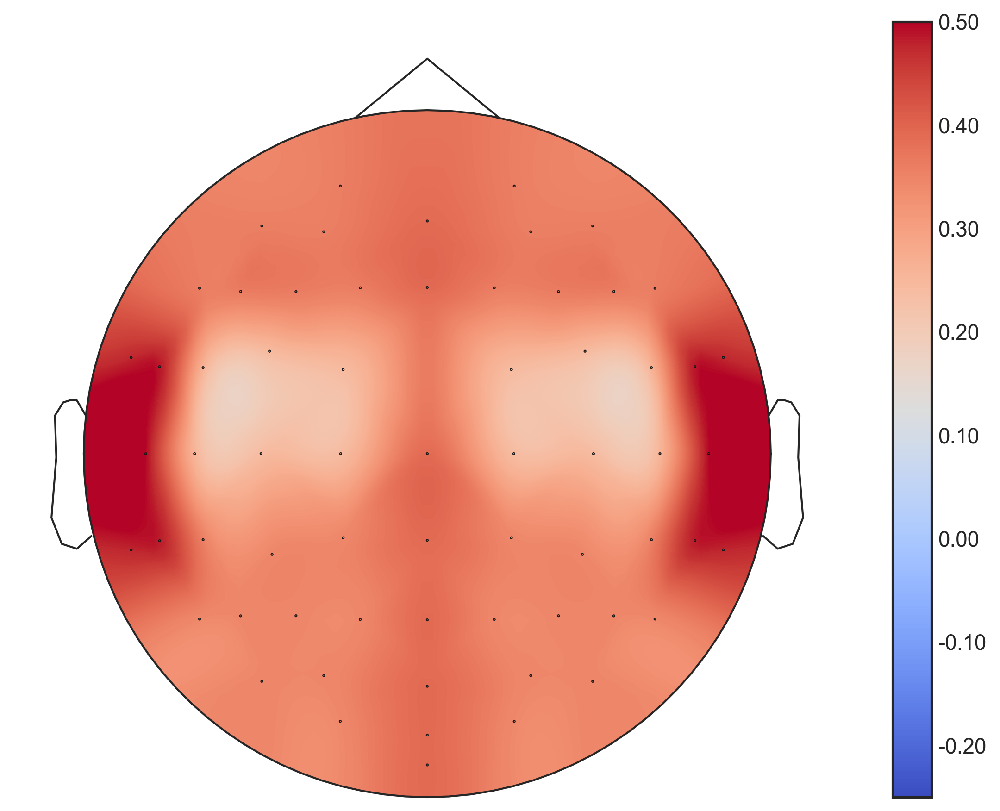

In [34]:
central_value = 0.241403
frontal_value = 0.358948
occipital_value = 0.343180
parietal_value = 0.344297
temporal_value = 0.479309
midline_value = 0.389621

plot_individual_topomap(regions, frontal_value, temporal_value, central_value, parietal_value, occipital_value, midline_value, vlim=(-0.25,0.5))

Unresponsive beta

In [35]:
beta_unresp = extract_contrast_values(df_beta_groups, 1, 'beta')
beta_unresp

{'central_value': -0.1265691256032749,
 'frontal_value': 0.42883447212083936,
 'occipital_value': 0.2566884943147895,
 'parietal_value': 0.17764687301743515,
 'temporal_value': 0.40835897376316693}

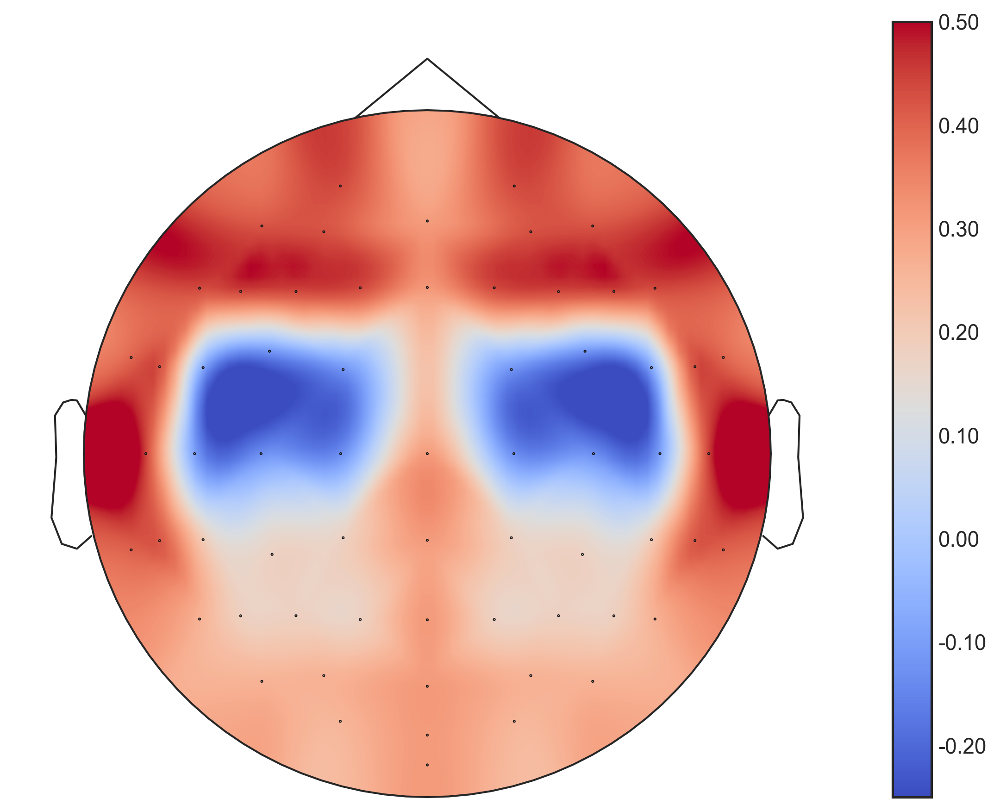

In [36]:
central_value = -0.126569
frontal_value = 0.428834
occipital_value = 0.256688
parietal_value = 0.177647
temporal_value = 0.408359
midline_value = 0.309241

plot_individual_topomap(regions, frontal_value, temporal_value, central_value, parietal_value, occipital_value, midline_value, vlim=(-0.25,0.5))

Responsive alpha

In [37]:
alpha_resp = extract_contrast_values(df_alpha_groups, 0, 'alpha')
alpha_resp

{'central_value': 0.11726363808856305,
 'frontal_value': 0.082872844573356,
 'occipital_value': 0.2378787583555551,
 'parietal_value': 0.1773964778578507,
 'temporal_value': 0.1582349993441326}

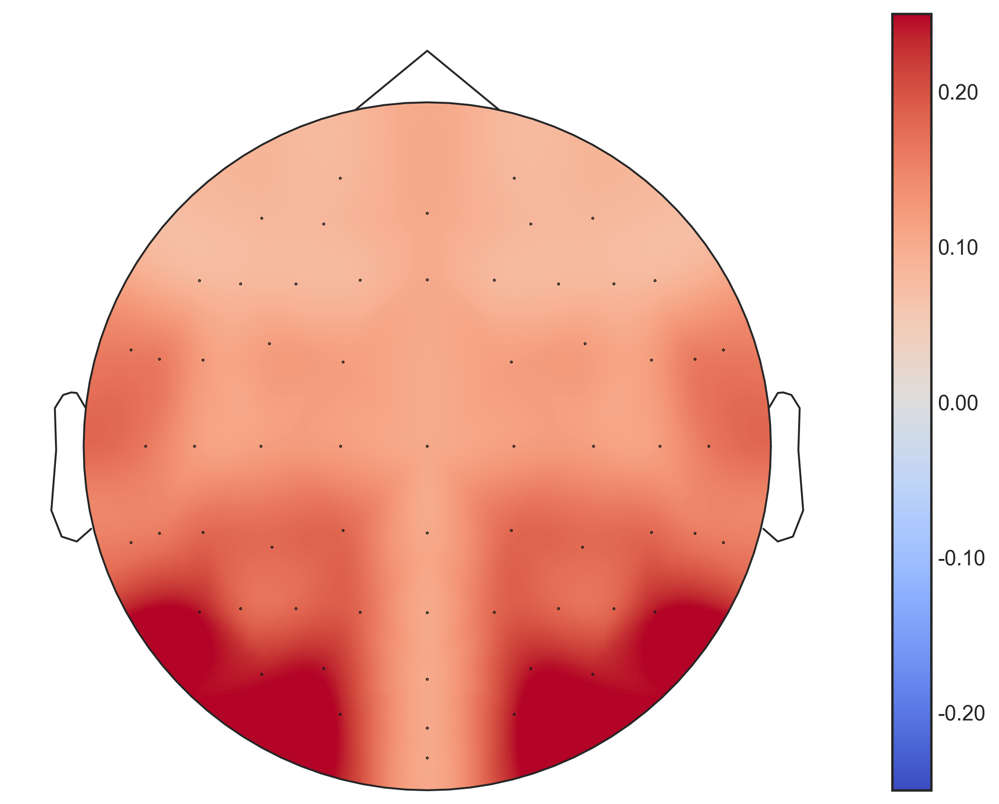

In [38]:
central_value= 0.11726363808856305
frontal_value= 0.082872844573356
occipital_value= 0.2378787583555551
parietal_value= 0.1773964778578507
temporal_value= 0.1582349993441326
midline_value= 0.103583

plot_individual_topomap(regions, frontal_value, temporal_value, central_value, parietal_value, occipital_value, midline_value, vlim = (-0.25,0.25))

Alpha unresponsive

In [39]:
alpha_unresp = extract_contrast_values(df_alpha_groups, 1, 'alpha')
alpha_unresp

{'central_value': 0.271217797762072,
 'frontal_value': -0.10501771654314987,
 'occipital_value': 0.11684619973940495,
 'parietal_value': 0.04095375096192053,
 'temporal_value': -0.015421511806870881}

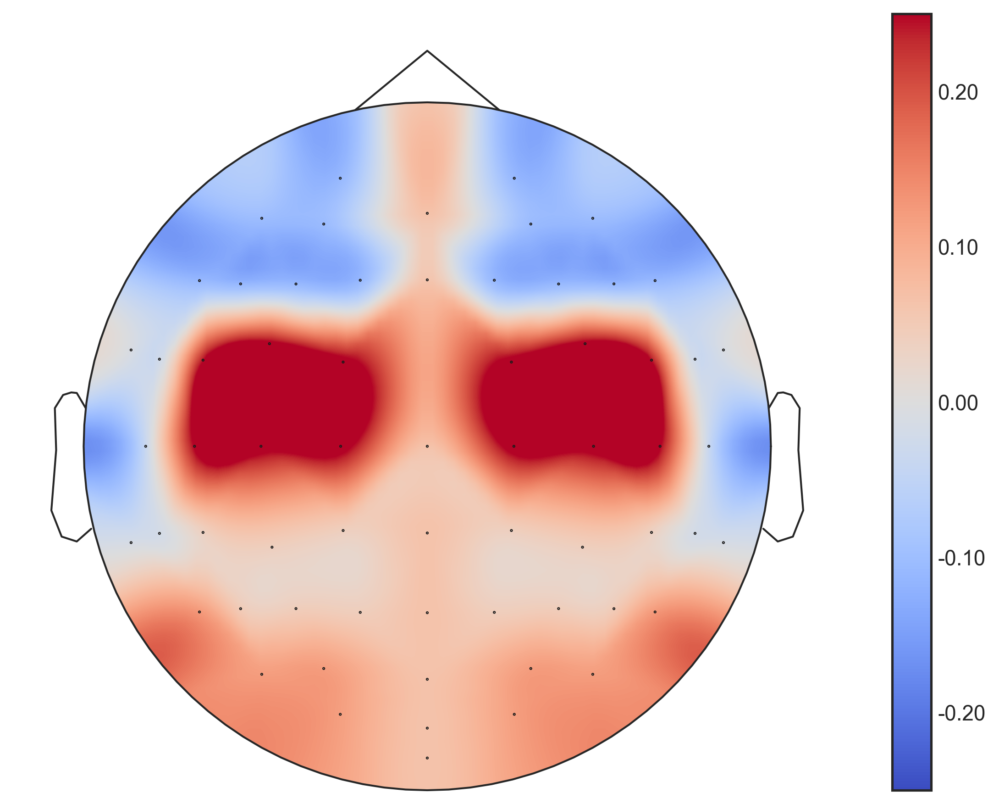

In [40]:
central_value = 0.271217797762072
frontal_value = -0.10501771654314987
occipital_value = 0.11684619973940495
parietal_value = 0.04095375096192053
temporal_value = -0.015421511806870881
midline_value = 0.064658

plot_individual_topomap(regions, frontal_value, temporal_value, central_value, parietal_value, occipital_value, midline_value, vlim = (-0.25,0.25))

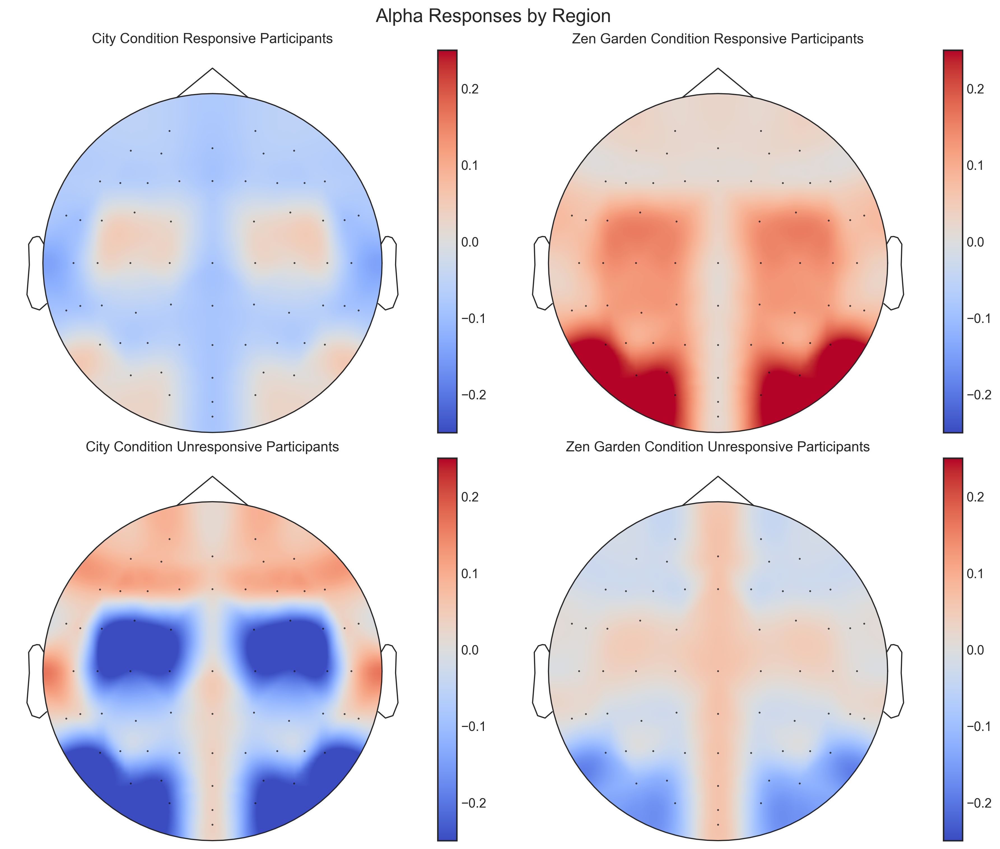

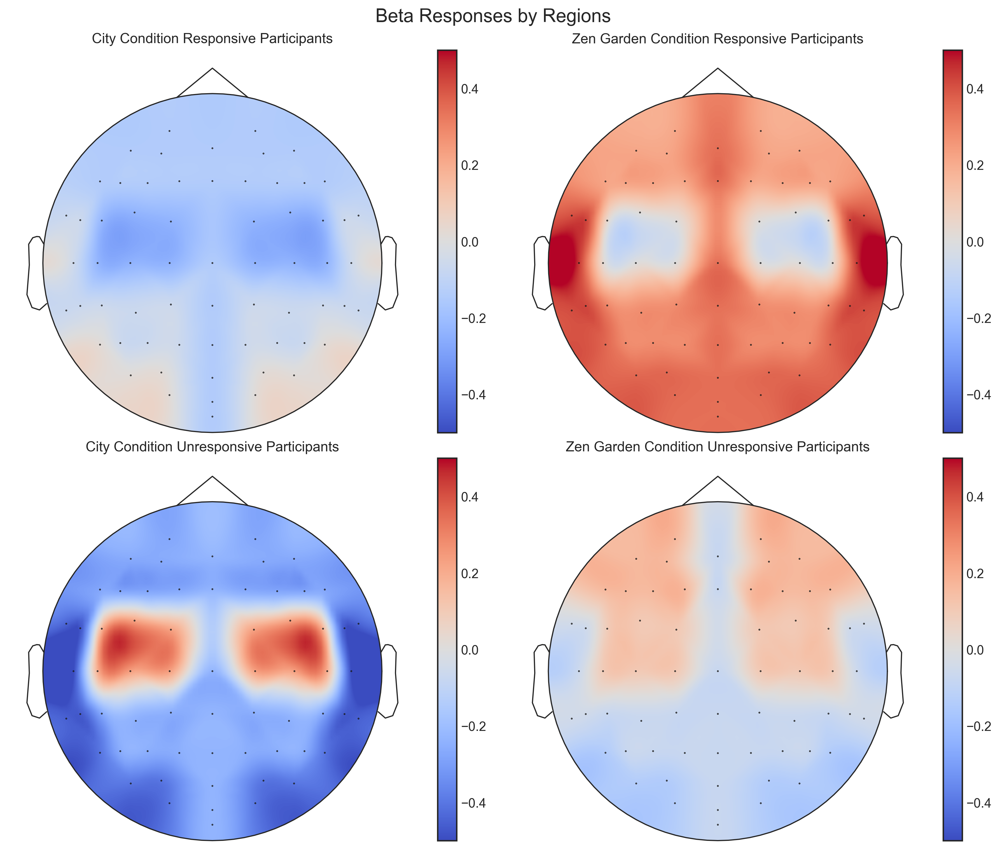

In [41]:
# Create signal info and set montage
signal_info = mne.create_info(regions['frontal'] + regions['temporal'] + regions['central'] + regions['parietal'] + regions['occipital'] + regions['midline'], 250, ch_types='eeg')
ten_twenty_montage = mne.channels.make_standard_montage('easycap-M1')
signal_info.set_montage(ten_twenty_montage)

# Define values for plotting
alpha_vals = [0.020820498535664447, 0.06990484258091732, 0.13123988004352433, 0.11581675072945374, 0.23857515075153,
              -0.06205234603769155, -0.08833015676321529, 0.01397624195496127, -0.061579727128396954, 0.0006963923959748819]

alpha_vals_un = [-0.022522060088283034, 0.0056894725927885215, 0.029997173791224355, -0.01896823259253102, -0.11559256787394427,
                 0.08249565645486684, 0.021110984399659402, -0.24122062397084765, -0.05992198355445155, -0.23243876761334922]

beta_vals = [0.21709189234264498, 0.4125164255363868, 0.005734900875482271, 0.2819277269078283, 0.3543351289166286,
             -0.14185561024827953, -0.06679273300087307, -0.23566809320175097, -0.06236966825806135, 0.011154975037981735]

beta_vals_un = [0.15969993999178891, -0.04725592587151601, 0.10393957707201729, -0.0708551516002107, -0.13746673753687044,
                -0.2691345321290504, -0.45561489963468293, 0.2305087026752922, -0.24850202461764584, -0.39415523185165996]

# Plotting function
def plot_topomaps(ax, vals, signal_info, title, vlim=None):
    if vlim is None:
        vlim = (-np.max(np.abs(vals)), np.max(np.abs(vals))) 
    im, _ = mne.viz.plot_topomap(vals, signal_info, axes=ax, cmap='coolwarm', contours=0, vlim=vlim, show=False)
    ax.set_title(title)
    return im

# Alpha Figure
fig_alpha, axs_alpha = plt.subplots(2, 2, figsize=(12, 10), constrained_layout=True)
fig_alpha.suptitle('Alpha Responses by Region', fontsize=16)

# Alpha Responsive (Condition 0: Zen Garden)
im = plot_topomaps(axs_alpha[0, 1], list(np.ones(len(regions['frontal'])) * alpha_vals[0])
                                   + list(np.ones(len(regions['temporal'])) * alpha_vals[1])
                                   + list(np.ones(len(regions['central'])) * alpha_vals[2])
                                   + list(np.ones(len(regions['parietal'])) * alpha_vals[3])
                                   + list(np.ones(len(regions['occipital'])) * alpha_vals[4])
                                   + list(np.ones(len(regions['midline'])) * 0.017610), 
                  signal_info, 'Zen Garden Condition Responsive Participants', vlim=(-0.25,0.25))
fig_alpha.colorbar(im, ax=axs_alpha[0, 0], orientation='vertical')

# Alpha Responsive (Condition 1: City)
im = plot_topomaps(axs_alpha[0, 0], list(np.ones(len(regions['frontal'])) * alpha_vals[5])
                                   + list(np.ones(len(regions['temporal'])) * alpha_vals[6])
                                   + list(np.ones(len(regions['central'])) * alpha_vals[7])
                                   + list(np.ones(len(regions['parietal'])) * alpha_vals[8])
                                   + list(np.ones(len(regions['occipital'])) * alpha_vals[9])
                                   + list(np.ones(len(regions['midline'])) * -0.085972), 
                  signal_info, 'City Condition Responsive Participants', vlim=(-0.25,0.25))
fig_alpha.colorbar(im, ax=axs_alpha[0, 1], orientation='vertical')

# Alpha Unresponsive (Condition 0: Zen Garden)
im = plot_topomaps(axs_alpha[1, 1], list(np.ones(len(regions['frontal'])) * alpha_vals_un[0])
                                   + list(np.ones(len(regions['temporal'])) * alpha_vals_un[1])
                                   + list(np.ones(len(regions['central'])) * alpha_vals_un[2])
                                   + list(np.ones(len(regions['parietal'])) * alpha_vals_un[3])
                                   + list(np.ones(len(regions['occipital'])) * alpha_vals_un[4])
                                   + list(np.ones(len(regions['midline'])) * 0.064658), 
                  signal_info, 'Zen Garden Condition Unresponsive Participants', vlim=(-0.25,0.25))
fig_alpha.colorbar(im, ax=axs_alpha[1, 0], orientation='vertical')

# Alpha Unresponsive (Condition 1: City)
im = plot_topomaps(axs_alpha[1, 0], list(np.ones(len(regions['frontal'])) * alpha_vals_un[5])
                                   + list(np.ones(len(regions['temporal'])) * alpha_vals_un[6])
                                   + list(np.ones(len(regions['central'])) * alpha_vals_un[7])
                                   + list(np.ones(len(regions['parietal'])) * alpha_vals_un[8])
                                   + list(np.ones(len(regions['occipital'])) * alpha_vals_un[9])
                                   + list(np.ones(len(regions['midline'])) * 0.034778), 
                  signal_info, 'City Condition Unresponsive Participants', vlim=(-0.25,0.25))
fig_alpha.colorbar(im, ax=axs_alpha[1, 1], orientation='vertical')

# Beta Figure
fig_beta, axs_beta = plt.subplots(2, 2, figsize=(12, 10), constrained_layout=True)
fig_beta.suptitle('Beta Responses by Regions', fontsize=16)

# Beta Responsive (Condition 0: Zen Garden)
im = plot_topomaps(axs_beta[0, 1], list(np.ones(len(regions['frontal'])) * beta_vals[0])
                                   + list(np.ones(len(regions['temporal'])) * beta_vals[1])
                                   + list(np.ones(len(regions['central'])) * beta_vals[2])
                                   + list(np.ones(len(regions['parietal'])) * beta_vals[3])
                                   + list(np.ones(len(regions['occipital'])) * beta_vals[4])
                                   + list(np.ones(len(regions['midline'])) * 0.343671), 
                  signal_info, 'Zen Garden Condition Responsive Participants', vlim=(-0.5, 0.5))
fig_beta.colorbar(im, ax=axs_beta[0, 0], orientation='vertical')

# Beta Responsive (Condition 1: City)
im = plot_topomaps(axs_beta[0, 0], list(np.ones(len(regions['frontal'])) * beta_vals[5])
                                   + list(np.ones(len(regions['temporal'])) * beta_vals[6])
                                   + list(np.ones(len(regions['central'])) * beta_vals[7])
                                   + list(np.ones(len(regions['parietal'])) * beta_vals[8])
                                   + list(np.ones(len(regions['occipital'])) * beta_vals[9])
                                   + list(np.ones(len(regions['midline'])) * -0.143178), 
                  signal_info, 'City Condition Responsive Participants', vlim=(-0.5, 0.5))
fig_beta.colorbar(im, ax=axs_beta[0, 1], orientation='vertical')

# Beta Unresponsive (Condition 0: Zen Garden)
im = plot_topomaps(axs_beta[1, 1], list(np.ones(len(regions['frontal'])) * beta_vals_un[0])
                                   + list(np.ones(len(regions['temporal'])) * beta_vals_un[1])
                                   + list(np.ones(len(regions['central'])) * beta_vals_un[2])
                                   + list(np.ones(len(regions['parietal'])) * beta_vals_un[3])
                                   + list(np.ones(len(regions['occipital'])) * beta_vals_un[4])
                                   + list(np.ones(len(regions['midline'])) * -0.073285), 
                  signal_info, 'Zen Garden Condition Unresponsive Participants', vlim=(-0.5, 0.5))
fig_beta.colorbar(im, ax=axs_beta[1, 0], orientation='vertical')

# Beta Unresponsive (Condition 1: City)
im = plot_topomaps(axs_beta[1, 0], list(np.ones(len(regions['frontal'])) * beta_vals_un[5])
                                   + list(np.ones(len(regions['temporal'])) * beta_vals_un[6])
                                   + list(np.ones(len(regions['central'])) * beta_vals_un[7])
                                   + list(np.ones(len(regions['parietal'])) * beta_vals_un[8])
                                   + list(np.ones(len(regions['occipital'])) * beta_vals_un[9])
                                   + list(np.ones(len(regions['midline'])) * -0.231145), 
                  signal_info, 'City Condition Unresponsive Participants', vlim=(-0.5, 0.5))
fig_beta.colorbar(im, ax=axs_beta[1, 1], orientation='vertical')

plt.show()


____________

# ANCIENS CODES A IGNORER ? OU RETRAVAILLER NORMALISATION etc ? note à moi-même : remplacer par codes du notebook v10

# Violin plots to visualize condition x group

In [42]:
melted_data_new = pd.read_csv(join('..', 'Data', 'melted_data_new.csv'))
melted_data_new['condition'] = melted_data_new['condition'].apply(lambda x: 1 if x == 0 else 0)
melted_data_new['group'] = melted_data_new['group'].apply(lambda x: 1 if x == 0 else 0)
melted_data_new.head()

,ID,condition,group,variable,value
0,0,1,0,LF_avg,-0.968471
1,0,0,0,LF_avg,0.820515
2,1,1,0,LF_avg,-0.335525
3,1,0,0,LF_avg,2.022470
4,2,1,1,LF_avg,-0.821003


## CHANGER LE SCALE CAR PAS DES ZSCORES

Alpha

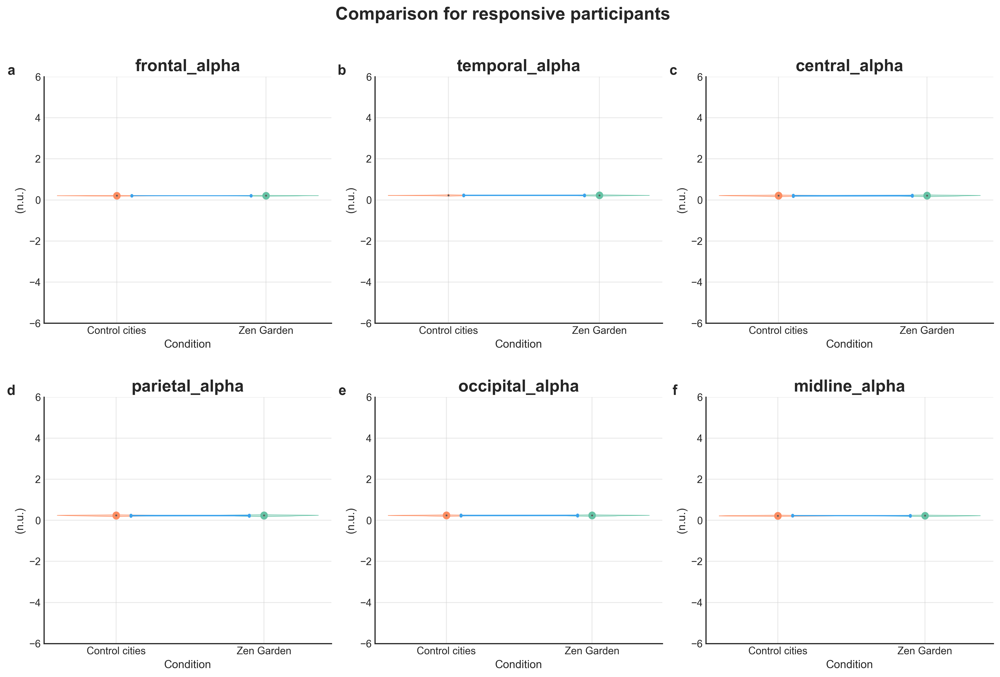

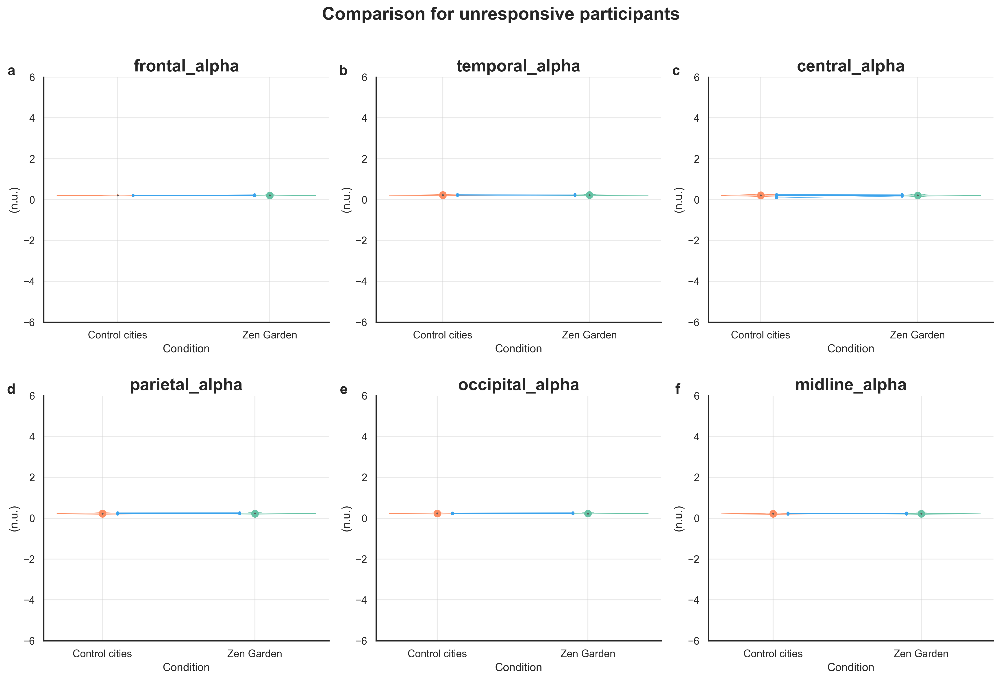

In [43]:
# CHANGE DATASET : ALL / PRE / POST

violin_plots_EEG_regions(melted_data_EEG_alpha_regions_POST, 0, 'responsive')
violin_plots_EEG_regions(melted_data_EEG_alpha_regions_POST, 1, 'unresponsive')

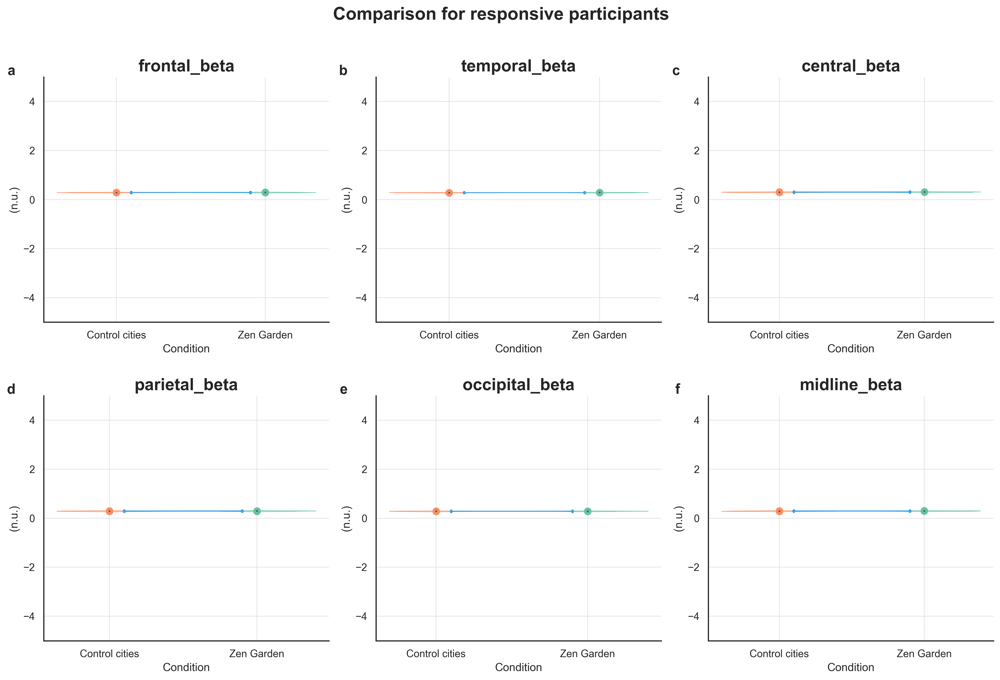

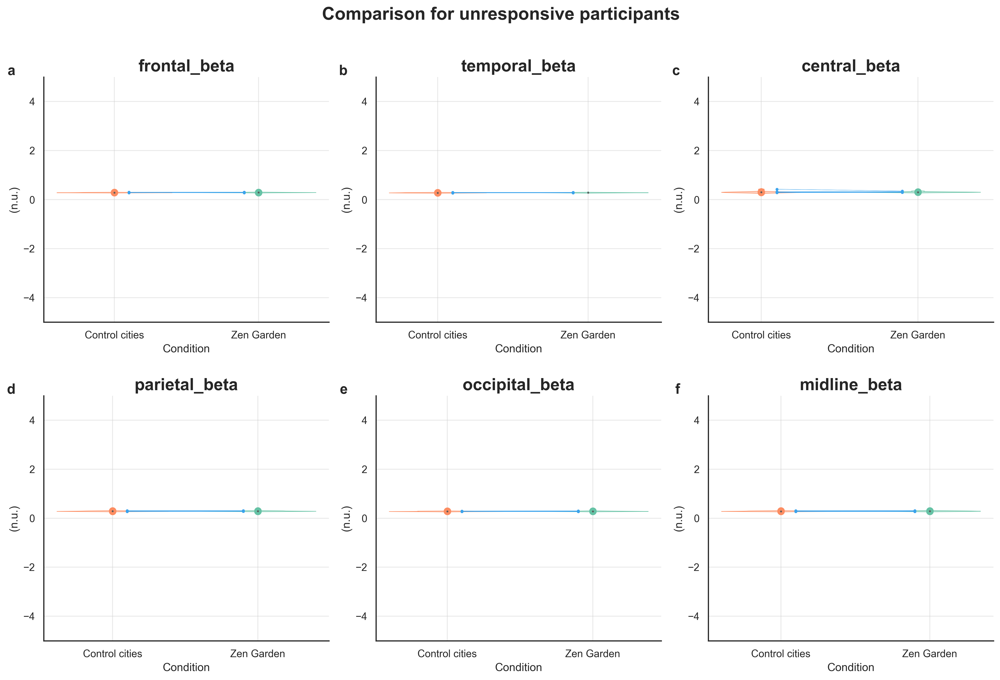

In [44]:
# CHANGE DATASET : ALL / PRE / POST
violin_plots_EEG_regions(melted_data_EEG_beta_regions_POST, 0, 'responsive', band='beta')
violin_plots_EEG_regions(melted_data_EEG_beta_regions_POST, 1, 'unresponsive', band='beta')